In [8]:
import matplotlib.gridspec as gridspec
import warnings
from sklearn.manifold import LocallyLinearEmbedding

warnings.filterwarnings('ignore')

import numpy as np
import seaborn as sns
import sklearn
import pickle
from IPython.display import display, HTML

sns.set()

import matplotlib.pyplot as plt
from sklearn import datasets
import pandas as pd
import matplotlib as mpl
import plotly.express as px

plt.rcParams['figure.figsize'] = [23, 13]
plt.rcParams['figure.dpi'] = 100 # from mpl_toolkits.mplot3d import Axes3D
mpl.rcParams['xtick.major.pad'] = 8
mpl.rcParams['ytick.major.pad'] = 8

from matplotlib import ticker
formatter = ticker.ScalarFormatter(useMathText=True)
formatter.set_scientific(True) 
formatter.set_powerlimits((-1,1)) 

def swiss_roll_example():
    '''
    Example code to show you how to load the swiss roll data and plot it.
    '''

    # load the dataset:
    X, color = datasets.make_swiss_roll(n_samples=2000)

    # plot the data:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=color, cmap=plt.cm.Spectral)
    plt.show()
    


In [9]:

TAKE_EIGEN_VALS = 0
SKIP_EIGEN_VALS = 1
current_rand=np.random.rand(4,4)

In [26]:
def euclidenDistance(data):
    """
    Building distance matrix by using the gram smchidt identity , Hij=Gii +Gjj -2Gij
    @param data:
    @return:
    """
    G=np.dot(data,data.T)
    diag=np.diag(G)
    H=diag+diag.T[:,np.newaxis]
    return H-2*G

In [25]:
def centerizedMatrix(data):
    """
    Simple centralizing by the formula given in class.
    @param data: 
    @return: centralized data.
    """
    n = data.shape[0]
    H=np.eye(n,n)-(1/n)*np.ones_like(data)
    return -(1/2)*(H@data@H)

In [24]:

def ExtractEigenValuesVectorsSorted(A,d,eig_vals_power=1,skip_first=False):
    """
    General function to extract eigenvalues and sort them , 
    np.vstack([eig_vals,eig_vecs])[:,np.argsort(eig_vals)] : Uses slicing by the sorted indexes therefor allow us
    to sort them effiecently.
    
    There is also skip_first flag which indicate if we're in diffusion map or not essentialy 
    and we skip the first eigenvalue."""
    if skip_first:
        i=1
    else:
        i=0
    eig_vals,eig_vecs=np.linalg.eig(A)
    eigs_vectors_and_vals=np.vstack([eig_vals,eig_vecs])[:,np.argsort(eig_vals)[::-1]]
    eig_vals=eigs_vectors_and_vals[TAKE_EIGEN_VALS,i:d+i][np.newaxis,:]
    eig_vals_pw_t=np.power(eig_vals,eig_vals_power)
    eig_vecs_tag=eigs_vectors_and_vals[SKIP_EIGEN_VALS:,i:d+i]
    return eig_vals_pw_t,eig_vecs_tag

In [22]:
def MDS(X,d , ret_eig_valus=False):
    '''
    Given a NxN pairwise distance matrix and the number of desired dimensions,
    return the dimensionally reduced data points matrix after using MDS.

    :param X: NxN distance matrix.
    :param d: the dimension.
    :return: Nxd reduced data point matrix.
    '''
    dists=euclidenDistance(X)
    centerized=centerizedMatrix(dists)
    eigen_vals,eig_vec=ExtractEigenValuesVectorsSorted(centerized,d)
    if ret_eig_valus:
        return eig_vec*eigen_vals,eigen_vals.real
    return eig_vec*eigen_vals

In [21]:

def heatKernelMatrix(data,sigma):
    """
    The heat kernel for each point is clacualted using :
    $K_{i,j}=e^{-||x_i-x_j||^2/\varepsilon}$
    Therefor the same trick as before can be applied , taking the distance matrix and applying np.exp(-dist/sigma).
    In this interpetation big values means small distance , and small values mean big distance. therefor the diag=1
    """
    distance_m=euclidenDistance(data)
    power= -distance_m/sigma
    return np.exp(power)


In [23]:
def stochasicMatrixFromKernel(kernelMatrix):
    """
    Normalizing the matrix.
    **kernelMatrix/(D[:,np.newaxis])**: 
    Since we want to normalize by rows  and D is a row vector , simply dividing by it will
    result in normalizing by rows , therefor we need to change it from (n,1) to (1,n) and the point wise division will
    be done by rows.
    Therefore we create a transition matrix  of a markov chain on the given n points , where probabilities correspond 
    to their distances.
    """
    D=kernelMatrix.sum(axis=1)  
    A=kernelMatrix/(D[:,np.newaxis])
    return A

In [15]:

def DiffusionMap(X, d, sigma, t):
    '''
    I didn't want to accidenly create bugs with the working code so I did hte bouns diffusion map over k-neighbors in seperate file.
    
    Given a NxD data matrix, return the dimensionally reduced data matrix after
    using the Diffusion Map algorithm. The k parameter allows restricting the
    kernel matrix to only the k nearest neighbor of each data point.
    
    Decompose A into its eigenvector ,and select only the 2,..,(d+1) highest eigenvalues , return the final vectors mulitpled
    by power t of the eigenvalues.
    
    :param X: NxD data matrix.
    :param d: the dimension.
    :param sigma: the sigma of the gaussian for the kernel matrix transformation.
    :param t: the scale of the diffusion (amount of time steps).
    :return: Nxd reduced data matrix.
    '''
    K=heatKernelMatrix(X,sigma)
    A=stochasicMatrixFromKernel(K)
    eig_val,eig_vecs=ExtractEigenValuesVectorsSorted(A,d,eig_vals_power=t,skip_first=True)

    return eig_val*eig_vecs,A


In [16]:
"""
Laying the ground work for comparing between the eignvalues based on the rotated dataset.
Creating random rotation matrix using the QR Decomp :
"""
random_guass=np.random.normal(0,1,size=(3,3))
rotatin_matrix=np.linalg.qr(random_guass)[0]

In [17]:

n_samples=100
random_2d=np.random.rand(n_samples,2)

In [27]:
def get_noise_data(noises):
    """
    Add differnt amount of noise.
    """
    data_with_noise=[]
    for sd in noises:
        data_with_noise.append(random_2d+np.random.normal(0,scale=sd))
    return data_with_noise    

In [28]:
def get_eigenvalues(data,noise):
    """
    Get eigenvalues from MDS with noise.
    """
    to_transfer=np.hstack([data,np.zeros(n_samples).reshape(-1,1)])
    matrix_rotated=to_transfer@rotatin_matrix
    matrix_rotated+=np.random.normal(0,scale=noise,size=matrix_rotated.shape)
    return MDS(matrix_rotated,3,ret_eig_valus=True)[1]

def average_eigens_values(data, iters, noise):
    """
    Avereage of the eigenvalues distribution for the current noise.
    """
    eigen_vals=np.zeros(3)
    for i in range(iters):
            curr_eigen_vals=get_eigenvalues(data,noise).flatten()
            eigen_vals+=curr_eigen_vals
    eigen_vals=eigen_vals/iters
    return eigen_vals


def plot_box_graphs(eigen_dist, noises):
    """
    Plot box graphs for the distributions of lambda on a given noise.
    """
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure()
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])
    ax3 = fig.add_subplot(gs[1, :])
    eigen_dist_big_20=eigen_dist[eigen_dist["$\sigma$"]>noises[4]]
    eigen_dist_small_20=eigen_dist[eigen_dist["$\sigma$"]<=noises[4]]
    sns.boxplot("$\sigma$","$\lambda$", hue="$\lambda_i$", data=eigen_dist,ax=ax3).set_title("Different noises comparison")
    sns.boxplot("$\sigma$","$\lambda$", hue="$\lambda_i$", data=eigen_dist_small_20,ax=ax1).set_title("Comparing small noises")
    sns.boxplot("$\sigma$","$\lambda$", hue="$\lambda_i$", data=eigen_dist_big_20,ax=ax2)\
        .set_title("Comparing large noises.")
    fig.suptitle("Comparing the effect of gradually increasing noise levels mean and var of the eigen values"
                 " , each eigen value is sampled 1000 times for each noise level.\nFigure 0")
    plt.show()
def sample_eigenvectors(data, iters, noises):
    """
    Data : 
    iters : How many time do we want to samples
    noises : The different noises distribtuions to sample from them.
    """
    eigen_values=pd.DataFrame(columns=["$\lambda_0$","$\lambda_1$","$\lambda_2$","$\sigma$"])
    eigen_dist=pd.DataFrame(columns=["$\lambda$","$\lambda_i$","$\sigma$"])
    i=0
    eigen_vals=np.zeros(iters*len(noises)*3)
    eigen_nums= np.tile(np.arange(3)[::-1],iters*len(noises))
    noise_levels=np.zeros(iters*len(noises)*3)
    for noise in noises:
        for iter in range(iters):
            curr_eigen_vals=get_eigenvalues(data,noise).flatten()
            eigen_values.loc[i]=np.append((curr_eigen_vals),noise)
            eigen_vals[i*3:i*3+3]=curr_eigen_vals
            noise_levels[i*3:i*3+3]=noise
            i+=1
    eigen_dist["$\lambda$"]=eigen_vals
    eigen_dist["$\lambda_i$"]=eigen_nums
    eigen_dist["$\sigma$"]=noise_levels
    # display(eigen_dist)
    # display(eigen_values)
    return eigen_dist, eigen_values

def plot_dist_comparision_eigen_values(eigen_values, noises):
    """
    Plotting the dist comparsion between the eigenvalues given an amount of noise.
    """
    fig,ax=plt.subplots(2,5,figsize=(30,15))
    flatten_axs=ax.flatten()
    i=0
    j=0
    for noise in noises:
        eig_val_current=eigen_values[eigen_values["$\sigma$"]==noise]
        sns.distplot(eig_val_current["$\lambda_0$"],ax=ax[i,j],axlabel="$\lambda$ values",label="$\lambda_0$")
        sns.distplot(eig_val_current["$\lambda_1$"],ax=ax[i,j],axlabel="$\lambda$ values",label="$\lambda_1$")
        sns.distplot(eig_val_current["$\lambda_2$"],ax=ax[i,j],axlabel="$\lambda$ values",label="$\lambda_2$").set_title("sigma="+str(noise))
        ax[i,j].tick_params('x',labelrotation=45)
        explained_variance = eig_val_current.mean(axis=0)[:3]
        explained_variance_ratio=explained_variance/explained_variance.sum()
        ax[i,j].text(0.02, 0.98, "Explaind variance ratio:\n"+explained_variance_ratio.to_string(), ha="left", va="top", transform=ax[i,j].transAxes) #add text
        ax[i,j].legend()
        j+=1
        if j==5:
            i=1
            j=0
    fig.suptitle("Comparing the density and histograms of eigen values across different noise levels with 1000 for each lambda for each noise level.\nFigure 2")
    plt.show()
def comapre_explaind_variance(eigen_values,noises,iterations):
    """
    Compare the explaind variance and each componeents.
    """
    eigen_values=eigen_values.groupby(["$\sigma$"]).mean()
    eigen_values=eigen_values.div(eigen_values.sum(axis=1),axis=0)
    sns.lineplot(noises,y=eigen_values["$\lambda_0$"],label="$\lambda_0$")
    sns.lineplot(noises,y=eigen_values["$\lambda_1$"],label="$\lambda_1$")
    sns.lineplot(noises,y=eigen_values["$\lambda_2$"],label="$\lambda_2$").\
        set_title("Explained variance convergences over " +str(iterations) +" iterations")
    plt.ylabel("$\lambda$ explarined variance values")
    plt.xlabel("$\sigma$ values")
    plt.legend()
    plt.show()

In [ ]:
data=random_2d
noises= np.array([0,0.1,0.13,0.16,0.2,0.25,0.3,0.35,0.4,.45])
iters=1000
eigen_dist, eigen_values = sample_eigenvectors(data,iters,noises)

# Q1 : Comparing eigenvalues based on noise.
## Comapring eigenvalues on while the noise is small.

The following graphs give  us insights about the  distribution of eigenvalues under small amount of noise.

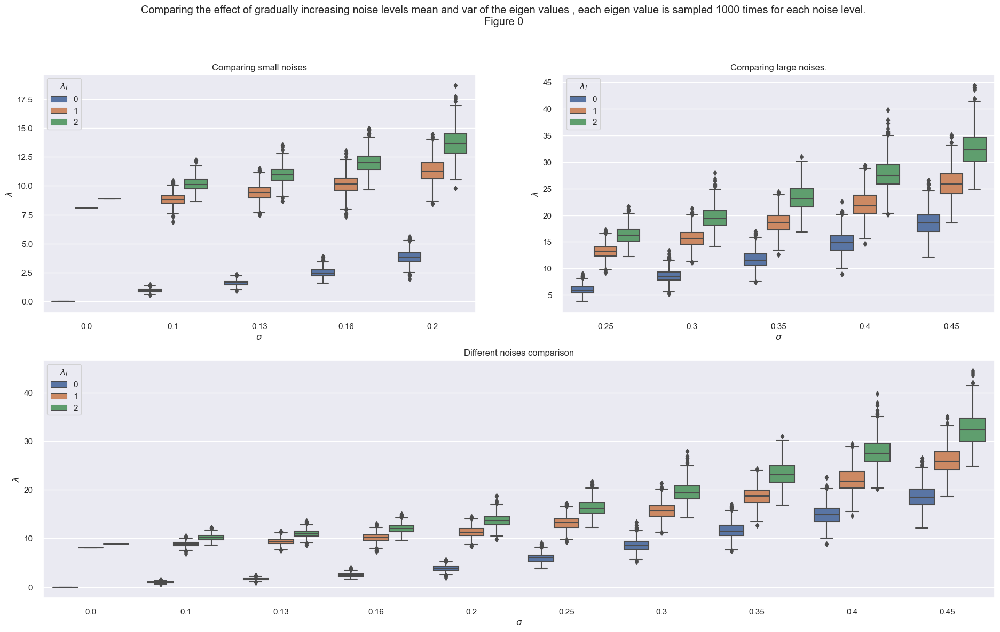

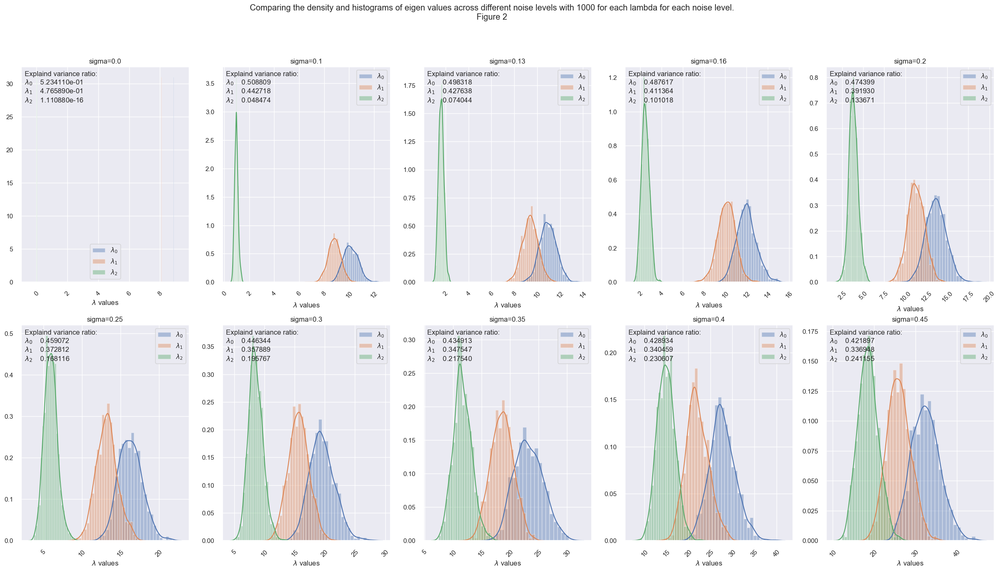

In [16]:
plot_box_graphs(eigen_dist,noises)
plot_dist_comparision_eigen_values(eigen_values,noises)


We can note a few patterns in the data :

When the noise is zero , the explained variance is held in the first 2 componenet while the 3rd one is 0. In
other words the MDS managed to perfectly conclude that an intristic dimension of dimension 2 exists , and he's only
rotated in space.

- the eigenvalues and their mean increase with the noise , and quite drastically.
- the 3rd eigenvalue will accumulate explained variance as the noise increases , it can be seen by the relative distance between
the distribution of each eigenvalue gradually decreasing as the noise increases(And by the data in the upper left of each graph)
,In other words as the noise increases in each axis the points start to gradually lose the global structure of a rotated
2d random space and another axis must come to the rescue in order to represent the data.
- the variance of the eigenvalues also increases with the noise , which make sense because if :

      $\sigma_n=n$

      $\forall_i \lim_{n\rightarrow\infty}corr(\lambda_{i},\sigma_n)=1$

    And it also shows in the graph.


- The distribution are approximately a Gaussian distribution , which make sense since the variance in each axis is
decided by the random noise added which is distributed Gaussian.
- The following equation holds in most of the distribution (as seen by the maxima point of the graph) :  $sd(\lambda_{2})<sd(\lambda_{1})<sd(\lambda_{0})$
Which actually make perfect sense since the mass for each distribution is 1 , but as you have more explained variance the
your variance will increase.

## Comparing eigen values insights for high noise :


In [17]:
#Sampling the high noise eigen values :
high_noises=noises*100
big_noise_ev_dist, big_noise_ev = sample_eigenvectors(data,iters,high_noises)

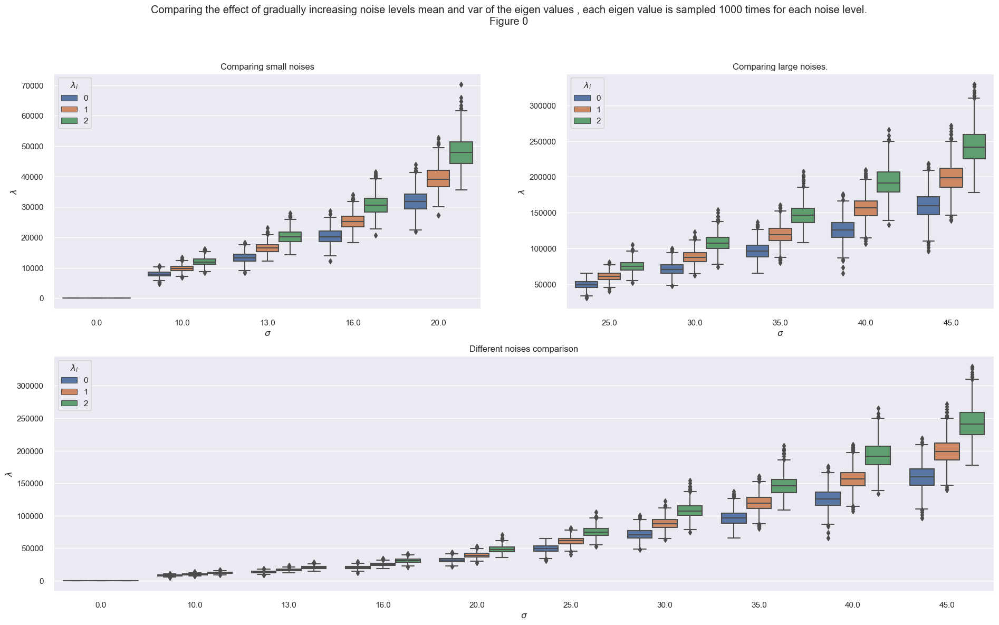

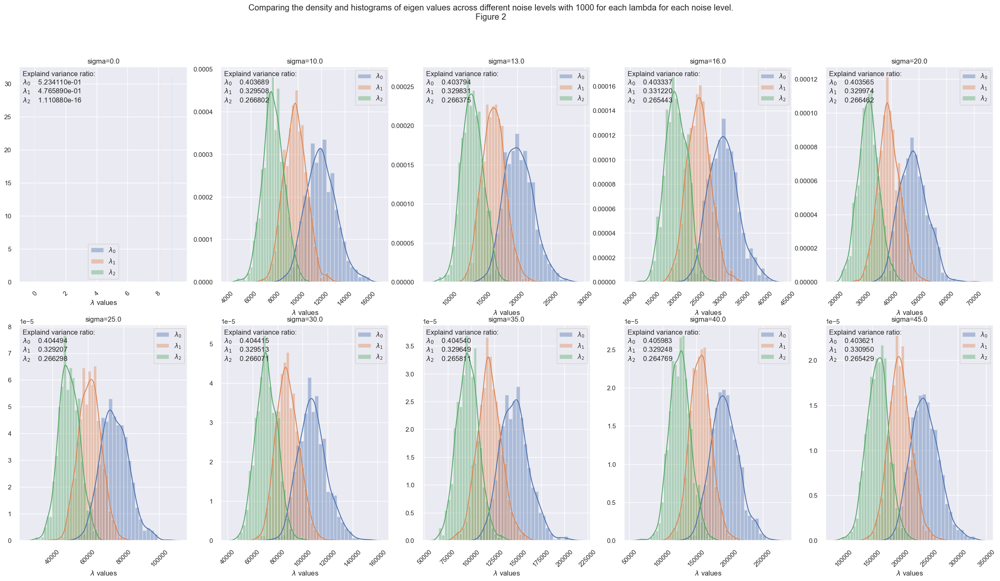

In [18]:
#Creating box and dist graph to compare between very high noises.
plot_box_graphs(big_noise_ev_dist,high_noises)
plot_dist_comparision_eigen_values(big_noise_ev,high_noises)

- explained variances doesn't reach a uniform distribution given that the data is distributed guassian apporximality , that's a bit suprising.

## Convergences of eigenvalues explaind variance ratio :
The following section will iterate over 200 different noise levels ranging from  0 to 1 and observe the convergence.
The amount of samples for each noise level is set to be 100.

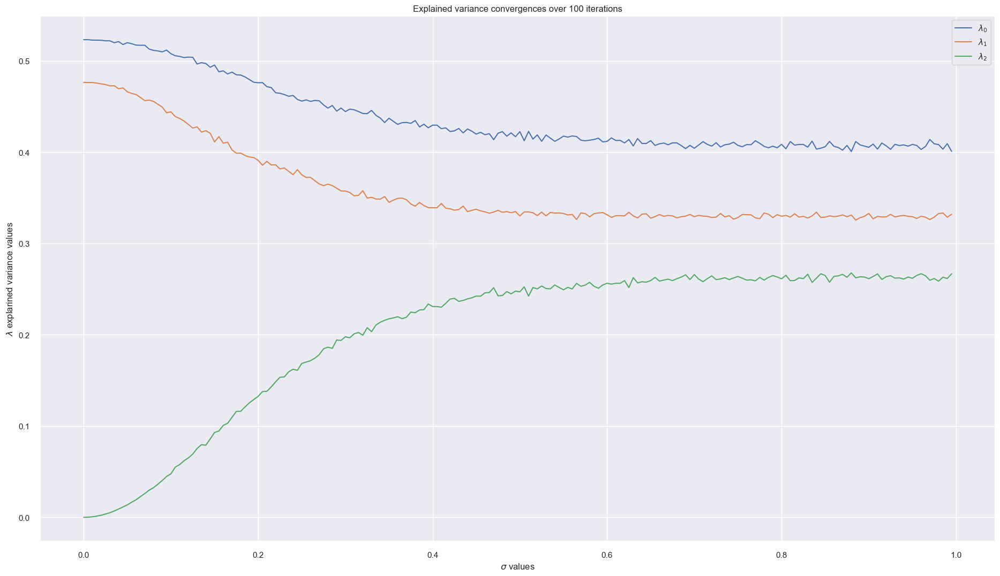

In [19]:
noise_long=np.arange(200)
noise_long=noise_long/200
iterations=100
a, eigen_values = sample_eigenvectors(data,iterations,noise_long)
comapre_explaind_variance(eigen_values,noise_long,iterations)


The tradeoff in variance between the 0st and 2rd componenet is clear , the 1nd componenets also loses some of it power
but most of the explaind varinace in the 2rd componenets came from the 0st component.




# Experemting with the swiss roll data

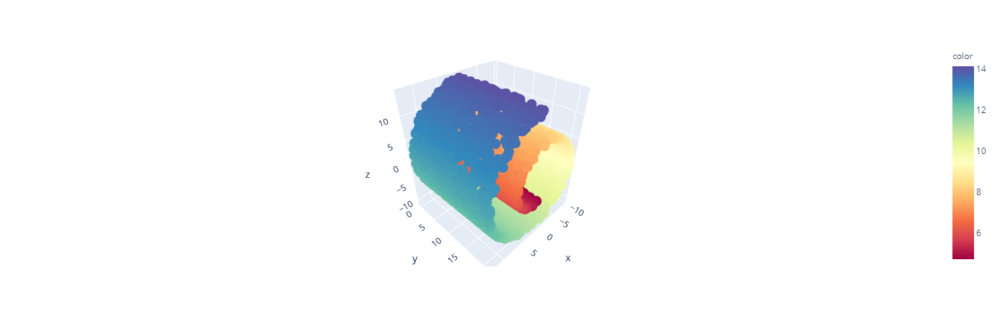

In [5]:
X,color=datasets.make_swiss_roll(n_samples=4000)
def d3_scatter(X,color):
    fig = px.scatter_3d(x=X[:, 0], y= X[:, 1], z=X[:, 2],
              color=color,opacity=1,color_continuous_scale='spectral')
    fig.show()

d3_scatter(X,color)

## Intrinsic dimension extracted by the MDS algorithm :
#### MDS optimization problem :

MDS is an algorithm that tries to transfer M points from $R^n$ to $R^p$ while approximately preserving the distances
of the original point , i.e. we want to solve the following optimization problem using EVD :

$min_{x_{1},x_{2},..,x_{m}}\sum_{i<j}\left(\left\Vert x_{i}-x_{j}\right\Vert -d_{ij}\right)^{2}$

the optimizing shows us that MDS main concern is about keeping the distances the same while reducing the dimension.
 Therefore, it can easily be seen that
The yellow points, and the blue points are farther apart in both cases , and everything in between remains approximate
at the same distance to each other.

#### using MDS in regard to manifold's just masochism:
Therefore, the reason he(MDS) couldn't roll out the swiss roll is that the data lives on a manifold and even
medium distances are just not accurate for manifolds.

Not only that , our optimization function require us to preserve all distance,
at any cost without regard to their size and then **we choose the new coordinates based on all possible  distances , large , small and medium**.
Which maybe wouldn't be so bad in other cases , but when the data lives on a manifold that's the worse thing you can do , we're not only
being ineffective we're actively hurting the inference of the intrinsic dimension since assuming 90% of the distances are not small then 90% of the data
is hindering  our ability  to infer the manifold underneath.

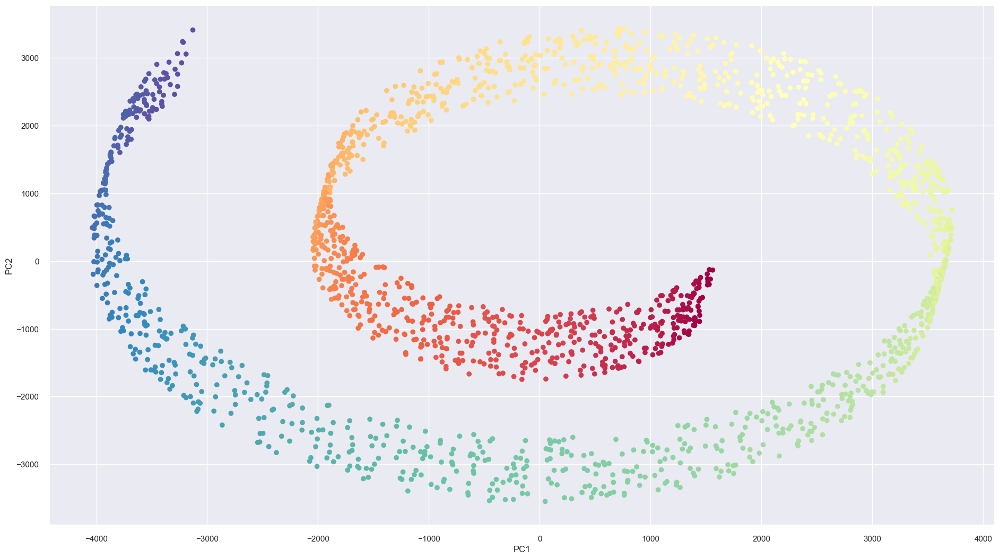

In [21]:
matrix_mds=MDS(X,2).real
plt.scatter(matrix_mds[:,0],matrix_mds[:,1],c=color,cmap=plt.cm.Spectral)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.show()

## Intersect dimension extracted by the LLE :

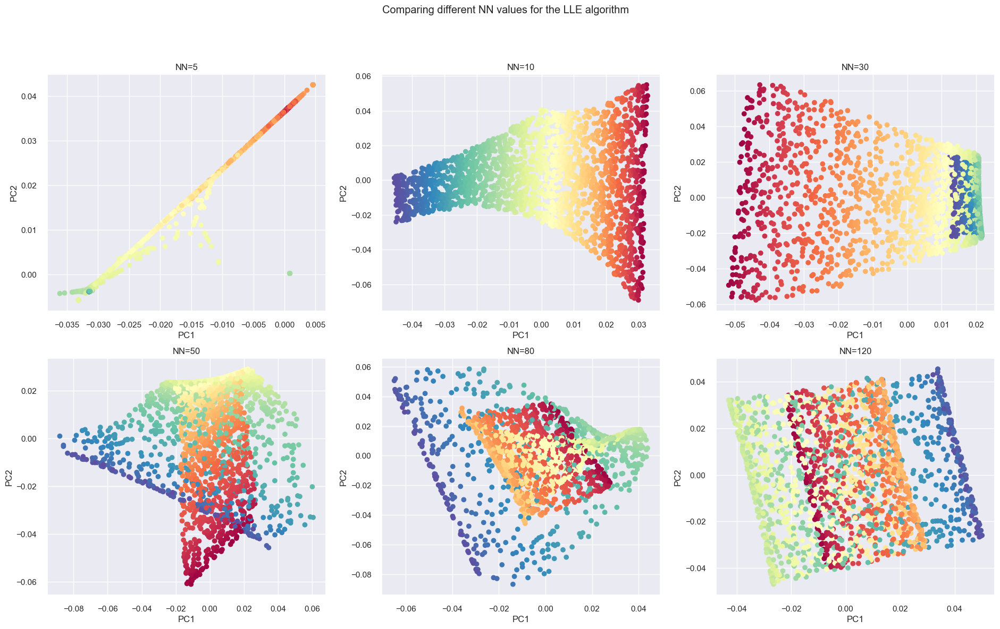

In [22]:
def plot_swiss_role_LLE(X,ax,nn=35,):
    embedding = LocallyLinearEmbedding(n_components=2,n_neighbors=nn)
    X_transformed = embedding.fit_transform(X)
    ax.scatter(X_transformed[:,0],X_transformed[:,1],c=color,cmap=plt.cm.Spectral)
    ax.set_title("NN="+str(nn))
    ax.set_xlabel("PC1")
    ax.set_ylabel("PC2")
f,ax=plt.subplots(2,3)

nn_range=[5,10,30,50,80,120]
for ax,nn in zip(ax.flatten(),nn_range):
    plot_swiss_role_LLE(X,ax,nn)
plt.suptitle("Comparing different NN values for the LLE algorithm")
plt.show()

## LLE goal :
LLE takes the K  closest data points to him  and reduce the dimension of each point separately based on
his k-neighbors using a linear dimension reduction, i.e. ,we base our optimization problems (finding the weights of the linear regerssion)
on small distances only , and the third part is built also on that logic , since the weights we optimized are solely used there
to optimize the intrinsic coordinates.

## Results
The LLE is designed to only account for small distances when optimizating the wieghts , i.e. ,
 he's designed to handle manifold! therefore it's not suprising that for the right NN values(for this data)
He manages to unfold the manifold well.

## Comparing different NN values :
The right NN value solely depends on the density and distribution of the points. in the case above I choose to
 extract samples=4000 and checked the results based on it , in the following section I explain the comparison
 between the different NN values.

- $NN$= 5 doesn't manage to get the manifold structure at all the colors over the spectrom are not quite accurcate..
The reason behind is an under fitted  model , he doesn't have enough data to accurately find the manifold , constructing
the weights $W$ based on 5  isn't doable for the current density(amount of samples).
-  $NN$=10 The reason for the good result is  that  $NN=10$ is enough information to reconstruct
 the weights and  find the manifold.
- NN=30,50,80,120 Here we completely lost the structure of the manifold , we can see it starting to collapse at 30 NN and getting
much worse at 50 , 80 and 120. The reason behind is when we have so much NN to choose from , we may accidentally choose one that's in the right
euclidean distance in the original dimension , but in our intrinsic dimension he's at the other edge of our world.

### Demonstartion for the poor performance of NN=30 :
A good example for that would be blue and orange , in the intrinsic dimension blue is located the edge of the manifold while orange
is located very close to the opposite edge , Therefore  a ball with sufficient radius could include only orange and blue points
, i.e , they'll be neighbors even thou it's extremely not accurate.
 I attached a graph of the MDS annotated with a circle that accurately represent the situation above.

 - Remark : for a certain threshold a blue point won't be a NN of an orange point , mainly because orange got NN from both sides while
 blue is isolated from one side.



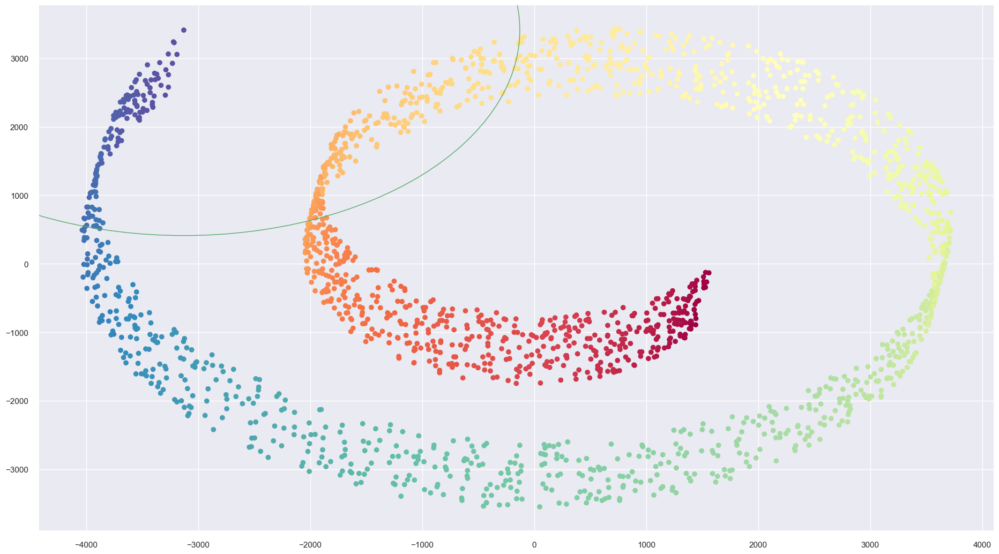

In [23]:
matrix_mds=MDS(X,2).real

i=np.argmax(color)

blue_point=matrix_mds[i,:]
ax=plt.gca()
ax.scatter(matrix_mds[:,0],matrix_mds[:,1],c=color,cmap=plt.cm.Spectral)
circle3 = plt.Circle((blue_point[0],blue_point[1]), 3000, color='g', fill=False)

ax.add_artist(circle3)

plt.show()

### Higher density and NN hyper parameter :
Higher density result in lower NN needed to achieve good results , a smaller epsilon ball is needed around $x_i$ to
capture K-NN as the density of the samples increases , smaller ball result in closer samples which result in improve
accuracy of the weights while maintaining the same NN hypermarket.


## Diffusion Map :

### Sigma : 
Sigma parameter allows to decide the distances.
- large sigmas will result in higher diffusion distance and therefor
the transition probability for distant points (from some point $x_i$ ) will increase , i.e. , as sigma increases
distant points will impact our dimensional reduction more.

- Small values of sigma will result in smaller diffusion distance , therefore only points that are close to the
original point will be accounted there.

-   If sigma equals inf then we'll get a uniform random walk distribution over the graph , therefore his balance his critical.


In other words , sigma decides our neighborhood size , big enough values will result in a spiral as well like
in the MDS case.

### t :
The diffusion at time t emanate the probability cloud from each point $x_i$ , therefor as t increases each point will
lose its origin and blend in with the rest of the points in her area. In practice this  tradeoff indicates 
 global vs local strcuture tradeoff.

- Large values of t mainly focus on preserving the global structure , infact for a large enough t all the points will
be in the same dot if there is only one connected component.

- Small values of t preserves the local strcuture , i.e. , the relation between points that are close to each other.


The tradeoff therefor has an ideal point to reduce dimension that perserve both. Thou they're some cases where we
only want to know a specefic property of the data and we use big\small values of t to find it.

Intirstic dimension extracted by the Diffusion map

In [4]:
def run_plot_diff_map(sigma,t,samples,plot3d_org=False , given_sample=False ,X_In=[],ret_fit=False,ax_flag=False,ax=None,no_c=False):
    X,color=datasets.make_swiss_roll(n_samples=samples)

    if given_sample:
        X,color=X_In

    X_fit,A=DiffusionMap(X=X,d=2,sigma=sigma,t=t)
    X_fit=X_fit.real

    if no_c:
        color=np.ones_like(color)
    if ax_flag:
        ax.scatter(X_fit[:, 0], X_fit[:, 1], c=color, cmap=plt.cm.Spectral)
    else:
        plt.scatter(X_fit[:, 0], X_fit[:, 1], c=color, cmap=plt.cm.Spectral)
        plt.show()

    if plot3d_org:
        d3_scatter(X,color)

    if ret_fit:
        return X_fit

## Parameter log:
sigma = 6 , t = 92500 , samples num =2000

 The high
value of t followed in stalin footsteps and infused communism deep within those points hearts. Therefor individuality
exists no more , the country  must persevere even if it means losing the individual unique qualities , i.e ,
we can see a *perfect* (ignoring the green points section) preservation of the global structure, but we lost all local structure.

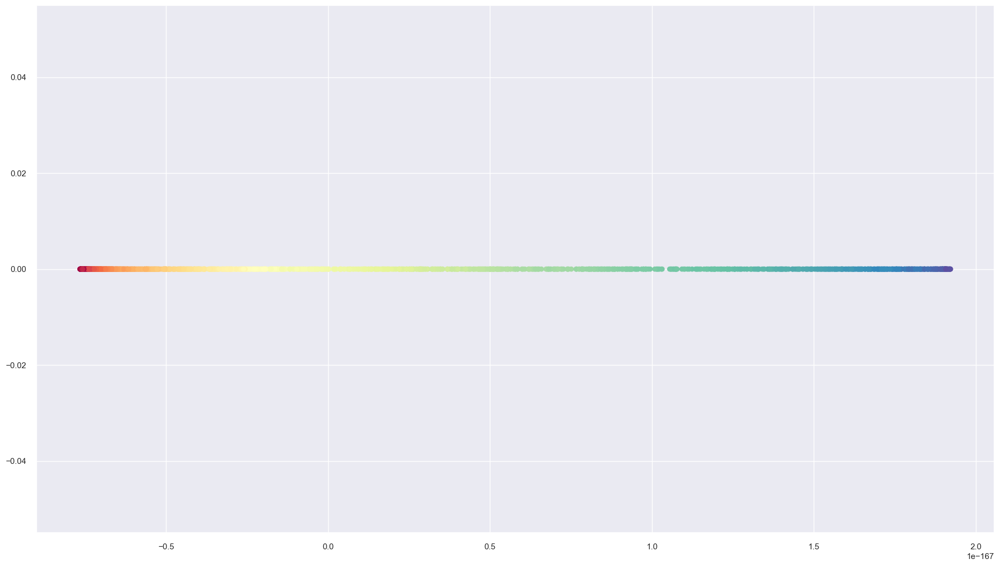

In [25]:
run_plot_diff_map(sigma=6,t=92500,samples=2000)


## Using diffusion map to extract local structure
### Samples = 2000 , sigma=6 , t =1


Small value of t and moderate sigma results in a mid point between the trade off. The global structure in itself
isn't perfect , we can see a little curve in the middle originate from the fact that the green points are in the
midway between both opposite sides , but the sparsity between the points increased in return. So we're in the middle
point of our trade off between t and sigma.

sigma=7 for pitfalls

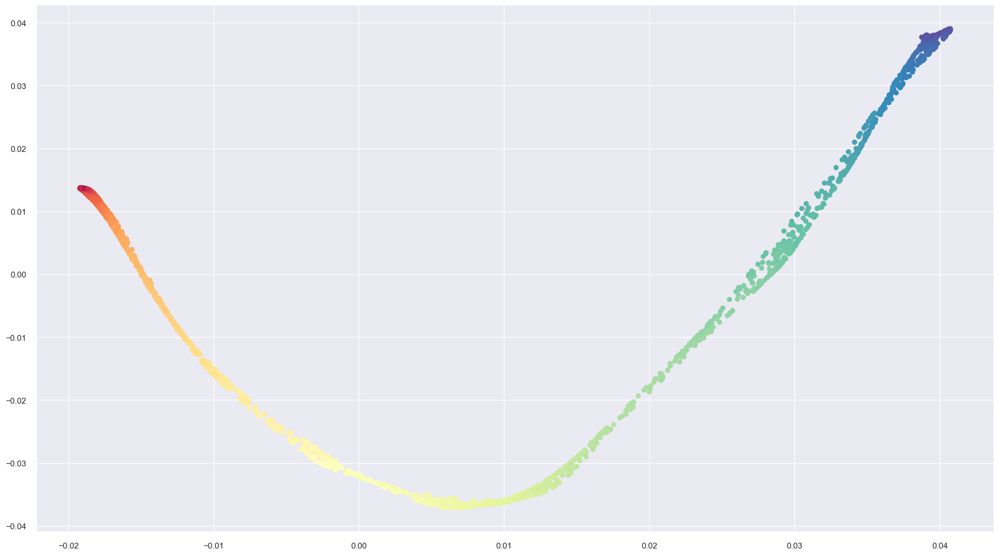

In [26]:
run_plot_diff_map(sigma=6.69,t=1,samples=2000)

## Using diffusion map to extract local structure

### Samples = 6000 , sigma=2e14, t =1 :

Here we focus on maintaining  the local structure while pretty much ignoring the global one and see what's
the diffusion map is capable of. A spiral was returned which make sense since we aim to lose global structure to gain
information about local one.The information about the local points is phenomenal ,  the density of the points in
the graph is almost a *perfect* fit for the original density ,as can be seen by the 3d plot attached.


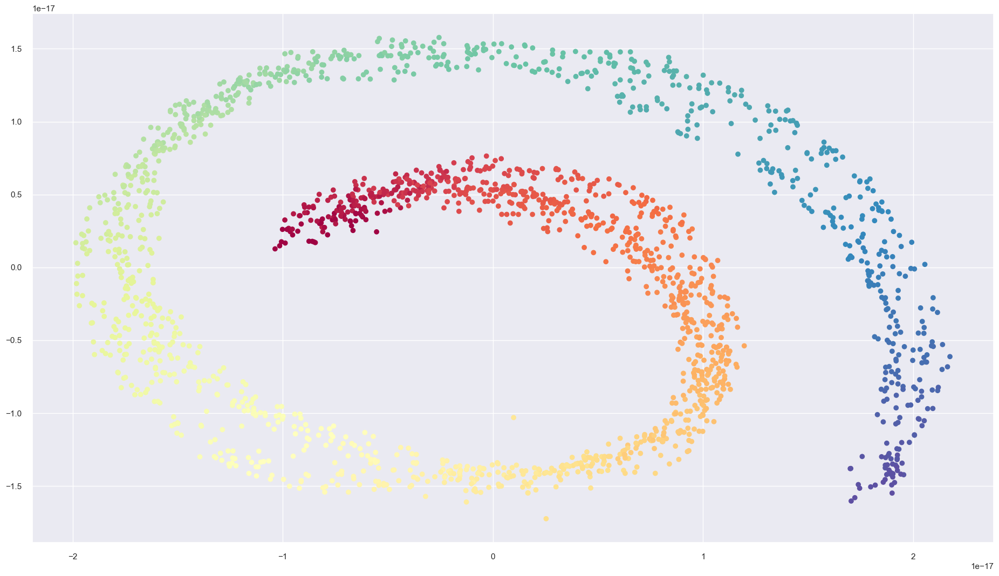

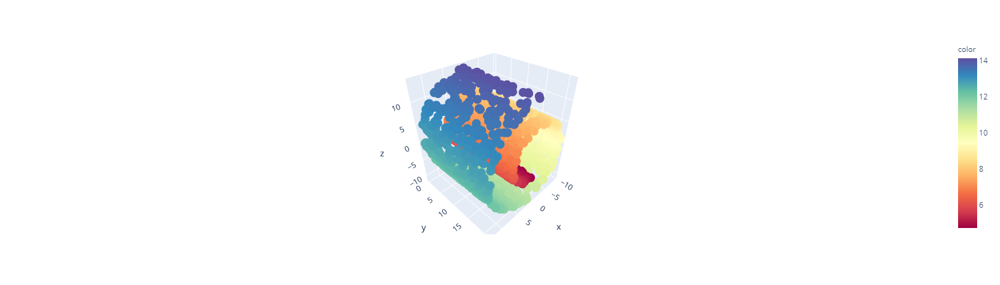

In [27]:
run_plot_diff_map(sigma=2e17,t=1,samples=2000,plot3d_org=True)

## Who won then?
The asnwer is it depends. If the user isn't familiar with ideas behind the algorithms , a simple LLE would be the best
for him. but if the user has a strong background and understanding of the algorithms then diffusion map is
*by far* better then LLE:
### Where did LLE went wrong :
LLE Never managed to infer the exact geometry , the rectangle he plotted at best was still a little disoriented toward
the red examples , i.e. the red spawns almost the entire y axis while the blues spawn only around 20% of him , this trend
continous with all the points in between as well , therefore he vastly misjudges  the width axis of the rectangle.

### Hyper parameters of Diffusion Map saves the day :
The hyper parameter allow us to research different scopes of the underlying structure , in fact
it is the *only*  algorithm (that I have seen so far) that is able to do that. Therefore,  extracting information from
each scope (local , global) by itself and then integrating the information to receive the full picture
results In the most accurate way. From the example above we can understand the y axis from the local Diffusion map, and  the x-axis from the global diffusion map , even without any colors given in advance its easy to infer that its a
rectangle based on those 2 alone , without ever seeing the original graph. I explained an algorithm below to also graph it , hopefully
its not complete nonsense.

## The plots below  are algorithem i came up with  to infuse the global and local structure  which gave nice results. the explantnation is in Infusing_global_local.ipynb. He probably won't work on complicated manifolds with out alot of extra work (probabiliy not at all haha) but it was fun :)

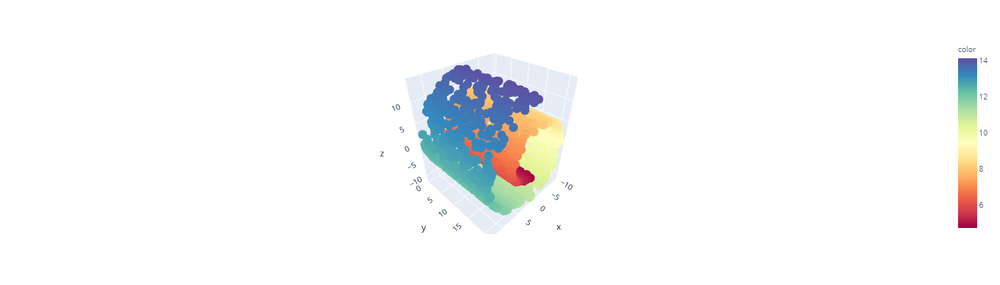

In [28]:
samples=2000
X,c_not_used=datasets.make_swiss_roll(n_samples=samples)
d3_scatter(X,c_not_used)

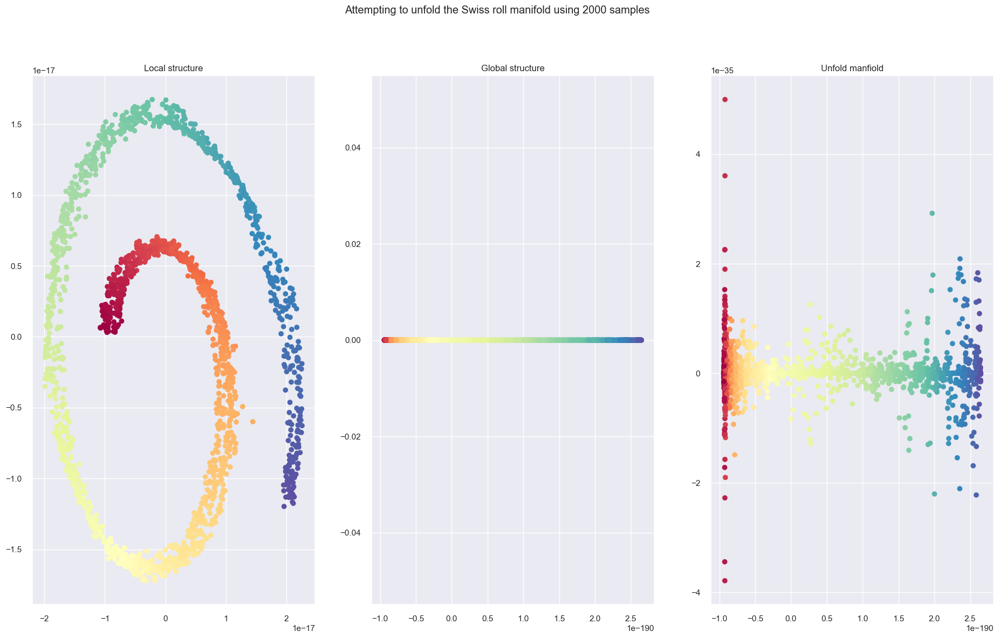

In [29]:
def rescale_linear(array, new_min, new_max):
    """Rescale an arrary linearly."""
    minimum, maximum = np.min(array), np.max(array)
    m = (new_max - new_min) / (maximum - minimum)
    b = new_min - m * minimum
    return m * array + b
samples=2000






fg,ax=plt.subplots(1,3)
fg.suptitle("Attempting to unfold the Swiss roll manifold using " +str(samples)+" samples")

ax[0].set_title("Local structure")
ax[1].set_title("Global structure")
ax[2].set_title("Unfold manfiold")
x_local=run_plot_diff_map(sigma=2e17,t=1,samples=samples,X_In=(X,c_not_used),given_sample=True,ret_fit=True,ax_flag=True,ax=ax[0])
X_global=run_plot_diff_map(sigma=6,t=100000,samples=samples,X_In=(X,c_not_used),given_sample=True,ret_fit=True,ax_flag=True,ax=ax[1])



def create_color_map():
    xx=(np.argsort(X_global,axis=0))[:,0]
    colors_grid=(np.arange(samples)+1)/samples
    colors=rescale_linear(colors_grid,4,14)
    match_color_in = np.vstack([xx.T,colors.T])
    match_color_in=match_color_in.T
    colors=match_color_in[np.argsort(match_color_in [:, 0])]
    colors=colors[:,1]
    return colors


colors = create_color_map()
curr_val=colors.min()

for val in rescale_linear(np.arange(500)+1,colors.min(),colors.max())[1:]:
    curr_batch=np.argwhere(((colors>curr_val) & (colors<val)))
    curr_val=val
    x=x_local[curr_batch][:,0,:]
    euc_dists = euclidenDistance(x)
    center_point=euc_dists.sum(axis=0).argmin() # minimal distance to everyone will be center point
    signs=curr_batch-curr_batch[center_point]
    y_axis_dist=euc_dists[:,center_point]*(np.sign(signs).reshape(1,-1))
    X_global[curr_batch,1]=y_axis_dist.reshape(-1,1)

ax[2].scatter(X_global[:, 0], X_global[:, 1], c=colors, cmap=plt.cm.Spectral)
plt.show()






## Checking the algorithm over the S shape manifold as well :

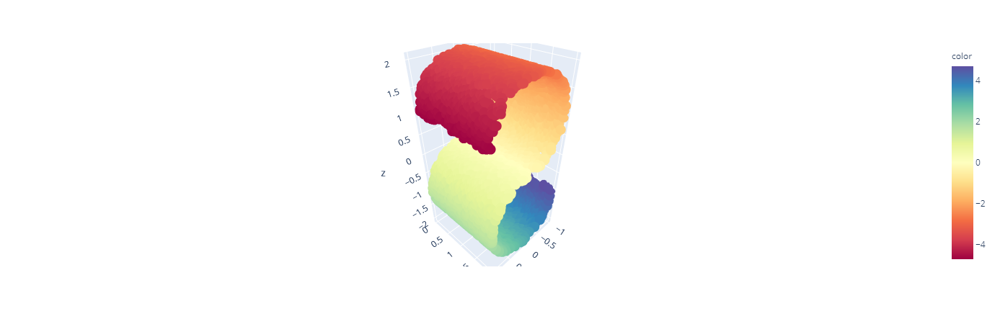

In [6]:
samples=4000
X,c_not_used=datasets.make_s_curve(n_samples=samples)
d3_scatter(X,c_not_used)

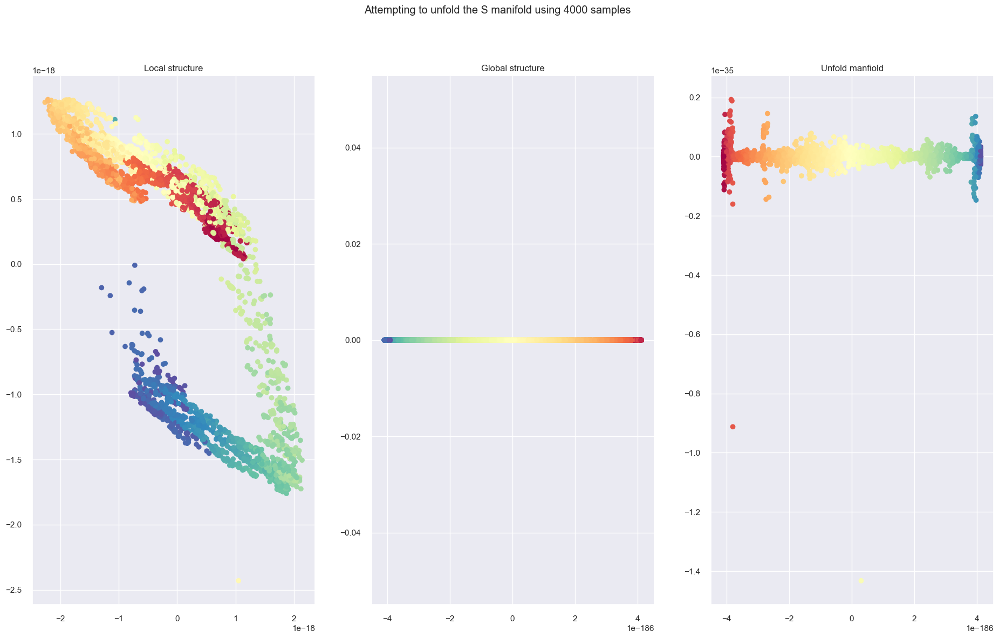

In [31]:
def rescale_linear(array, new_min, new_max):
    """Rescale an arrary linearly."""
    minimum, maximum = np.min(array), np.max(array)
    m = (new_max - new_min) / (maximum - minimum)
    b = new_min - m * minimum
    return m * array + b
samples=4000


fg,ax=plt.subplots(1,3)

fg.suptitle("Attempting to unfold the S manifold using " +str(samples)+" samples")
ax[0].set_title("Local structure")
ax[1].set_title("Global structure")
ax[2].set_title("Unfold manfiold")
x_local=run_plot_diff_map(sigma=1.355e16,t=1,samples=samples,X_In=(X,c_not_used),given_sample=True,ret_fit=True,ax_flag=True,ax=ax[0])
X_global=run_plot_diff_map(sigma=0.5,t=20000,samples=samples,X_In=(X,c_not_used),given_sample=True,ret_fit=True,ax_flag=True,ax=ax[1])



def create_color_map():
    xx=(np.argsort(X_global,axis=0))[:,0]
    colors_grid=(np.arange(samples)+1)/samples
    colors=rescale_linear(colors_grid,4,14)
    match_color_in = np.vstack([xx.T,colors.T])
    match_color_in=match_color_in.T
    colors=match_color_in[np.argsort(match_color_in [:, 0])]
    colors=colors[:,1]
    return colors


colors = create_color_map()
curr_val=colors.min()

for val in rescale_linear(np.arange(200)+1,colors.min(),colors.max())[1:]:
    curr_batch=np.argwhere(((colors>curr_val) & (colors<val)))
    curr_val=val
    x=x_local[curr_batch][:,0,:]
    euc_dists = euclidenDistance(x)
    center_point=euc_dists.sum(axis=0).argmin() # minimal distance to everyone will be center point
    signs=curr_batch-curr_batch[center_point]
    y_axis_dist=euc_dists[:,center_point]*(np.sign(signs).reshape(1,-1))
    X_global[curr_batch,1]=y_axis_dist.reshape(-1,1)


ax[2].scatter(X_global[:, 0], X_global[:, 1],c=colors, cmap=plt.cm.Spectral)
plt.show()

### Conclusion:
He managed to reach pretty good results for those cases , but they're very similiar. I wonder if he'll managed to handle
other manifolds as well.


# Faces Data set
_____

In [ ]:
def faces_example(path):
    '''
    Example code to show you how to load the faces data.
    '''

    with open(path, 'rb') as f:
        X = pickle.load(f)

    num_images, num_pixels = np.shape(X)
    d = int(num_pixels**0.5)
    print("The number of images in the data set is " + str(num_images))
    print("The image size is " + str(d) + " by " + str(d))

    # plot some examples of faces:
    plt.gray()
    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.imshow(np.reshape(X[i, :], (d, d)))
    plt.show()


# faces_example('faces.pickle')

with open('faces.pickle', 'rb') as f:
    X = pickle.load(f)

num_images, num_pixels = np.shape(X)
d = int(num_pixels**0.5)
print("The number of images in the data set is " + str(num_images))
print("The image size is " + str(d) + " by " + str(d))


MDS

In [33]:
def plot_with_images(X, images, title, image_num=25):
    '''
    A plot function for viewing images in their embedded locations. The
    function receives the embedding (X) and the original images (images) and
    plots the images along with the embeddings.

    :param X: Nxd embedding matrix (after dimensionality reduction).
    :param images: NxD original data matrix of images.
    :param title: The title of the plot.
    :param num_to_plot: Number of images to plot along with the scatter plot.
    :return: the figure object.
    '''

    n, pixels = np.shape(images)
    img_size = int(pixels**0.5)

    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.set_title(title)

    # get the size of the embedded images for plotting:
    x_size = (max(X[:, 0]) - min(X[:, 0])) * 0.08
    y_size = (max(X[:, 1]) - min(X[:, 1])) * 0.08

    # draw random images and plot them in their relevant place:
    for i in range(image_num):
        img_num = np.random.choice(n)
        x0, y0 = X[img_num, 0] - x_size / 2., X[img_num, 1] - y_size / 2.
        x1, y1 = X[img_num, 0] + x_size / 2., X[img_num, 1] + y_size / 2.
        img = images[img_num, :].reshape(img_size, img_size)
        ax.imshow(img, aspect='auto', cmap=plt.cm.gray, zorder=100000,
                  extent=(x0, x1, y0, y1))

    # draw the scatter plot of the embedded data points:
    ax.scatter(X[:, 0], X[:, 1], marker='.', alpha=0.7)

    return fig,ax

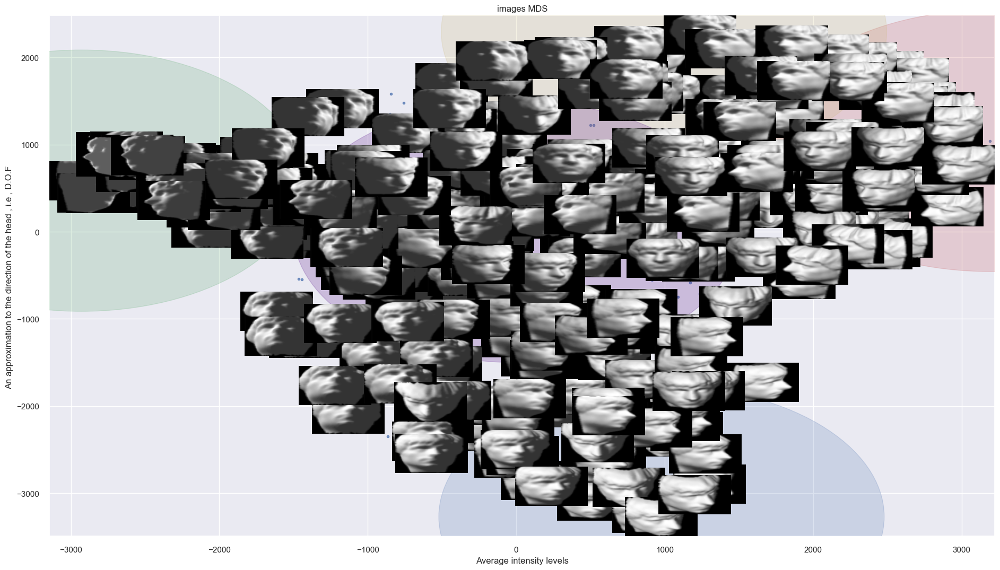

In [34]:
X_fit=MDS(X,2)

b,ax=plot_with_images(X_fit,X,"images MDS",image_num=400)
plt.xlabel("Average intensity levels")
plt.ylabel("An approximation to the direction of the head , i.e , D.O.F ")
min_x_val = X_fit[X_fit[:,0].argmin(),:]
max_x_val = X_fit[X_fit[:,0].argmax(),:]

min_y_val = X_fit[X_fit[:,1].argmin(),:]
max_y_val = X_fit[X_fit[:,1].argmax(),:]

alpha = 0.2
circle3 = plt.Circle((tuple(min_x_val)), 1500, color='g', fill=True,alpha=alpha,zorder=10,in_layout=True)
circle4 = plt.Circle((tuple(max_x_val)), 1500, color='r', fill=True,alpha=alpha,zorder=10,in_layout=True)
circle5 = plt.Circle((tuple(min_y_val)), 1500, color='b', fill=True,alpha=alpha,zorder=10,in_layout=True)
circle6 = plt.Circle((tuple(max_y_val)), 1500, color='y', fill=True,alpha=alpha,zorder=10,in_layout=True)
circle7 = plt.Circle((0,0), 1500, color='indigo', fill=True,alpha=alpha,zorder=10,in_layout=True)


ax.add_artist(circle3)
ax.add_artist(circle4)
ax.add_artist(circle5)
ax.add_artist(circle6)
ax.add_artist(circle7)


plt.show()


## MDS
-----
#### X- axis
Its clear that the X-axis features the average intensity level in the image.

- the <font color='red'>red Cluster</font> vs the  <font color='green'>Green</font>  demonstare the differences in the average
inteisty levels of the x axis.



#### Y-axis

##### Around (0,0) :
Since MDS is still a linear algorithem his approximation isn't perfect. The images he failed to recognize the D.O.F mostly
in the purple (indigo) area since they're located around (0,0) , if their projection isn't within a wide variance around
the x axis or y axis then it is a problematic problem since MDS couldn't understand its features and project it. Therefor
images in the purple circle are found that face negative direction , but are really close to each other.

##### Data points with high varaince :
Data points are far away from the center in some axis are an ok approximation of the D.O.F , it can be seen by  most
upper images face left or at least forward  and most lower images face right , or at least forward, but there is no clear distinction
between the forward and left\rght beside some clusters (Blue cluster , red cluster) so the error is quite high
.So we conclude that the algorithm isn't perfect since he's linear but his approximation gives us a general idea.








# LLE :
______
### N=15

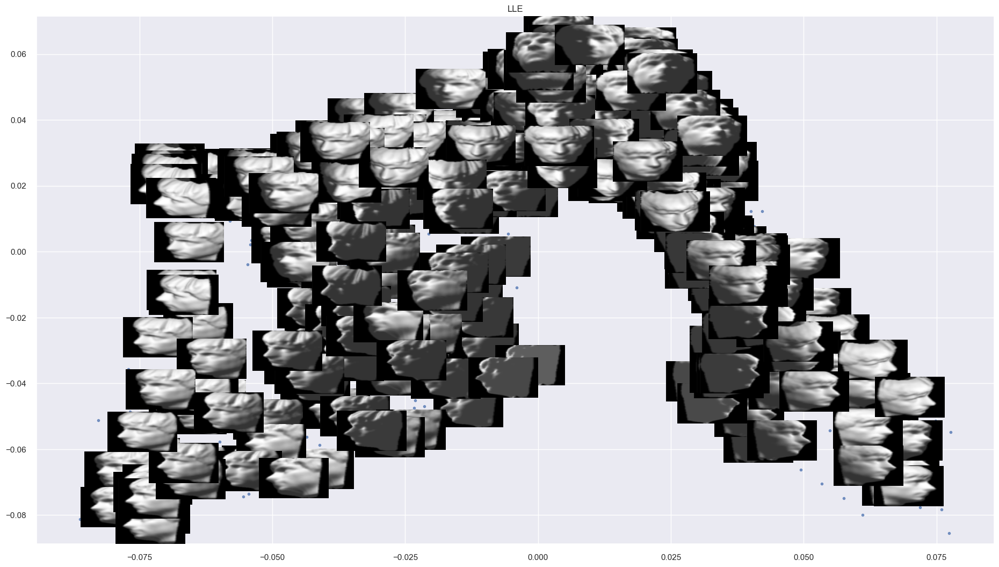

In [35]:
embedding = LocallyLinearEmbedding(n_components=2,n_neighbors=15)
X_transformed = embedding.fit_transform(X)
a=plot_with_images(X_transformed,X,"LLE",image_num=400)


##### X-axis
- Left : Facing right.
- Right : Facing left.
- Middle : Facing forward.

##### Y-axis :

- Up : Facing the oppostie direction.
- Down : Facing the same direction

##### So what happend here?
I think y and x axis explained variance budget is mainly going toward  D.O.F  , while the values around 0
are more likely to have low intensity average,  so LLE projected the intensity levels in an epslilon area around 0 where most
of hte points in this area tend to have  much smaller  intensity levels. There is no denying the extreme intensity  value difference between
points in that are distant from from 0 in the x axis.

In other words , there is no clear explanation for each axis. We can conclude that  there is a cluster of low intensities around
the (0,0) point.

- Small y axis values result in facing foward.
- middle-high X values tend to face right and left respectivliy to being positive or negative ,
 - Positive X - Facing left
 - Negative X - facing right.

####  Conclusion :
He managed to seperate the dataset by D.O.F perfectly give a very good approximation of the intensity levels , but he didn't managed to create
a grid of intensities over some axis and only managed to get the intensites levels through cluster. Therefor he's an improvment over the MDS since he's far
more accurcate, but I hope that the Diffusion map can divide the data into 2 axis ,
The intensity and the D.O.F in a neat manner.



# Diffusion Map
_____
We have more power to control the neighbrhood and the strcutre levels with Diffusion map , therefor I hope
I can seperate the x-axis and y-axis into I.L. and D.O.F.

Hyper parameter searching :
a gradually increased sigma to get a good estimation of the local structure , afterwards
increased t gradually until he corrected the global structure to a good approximation.


I couldn't managed to sub plots the graphs because the supplied function makes it much more complicated.
Therefor i plotted them one by one and there is no option to see them side by side , Sorry.

#### Finding sigma :
The area im concerned about is the intensity levels since it seems that the D.O.F is relatively  known from the start. We can see
that in  the first graph the low intensity level area is very dense and "collapsed" therefore there is a need to separate the entanglement  the cluster.
It can be done by first trying to maximize the local structure by increasing sigma to be incredibly large.



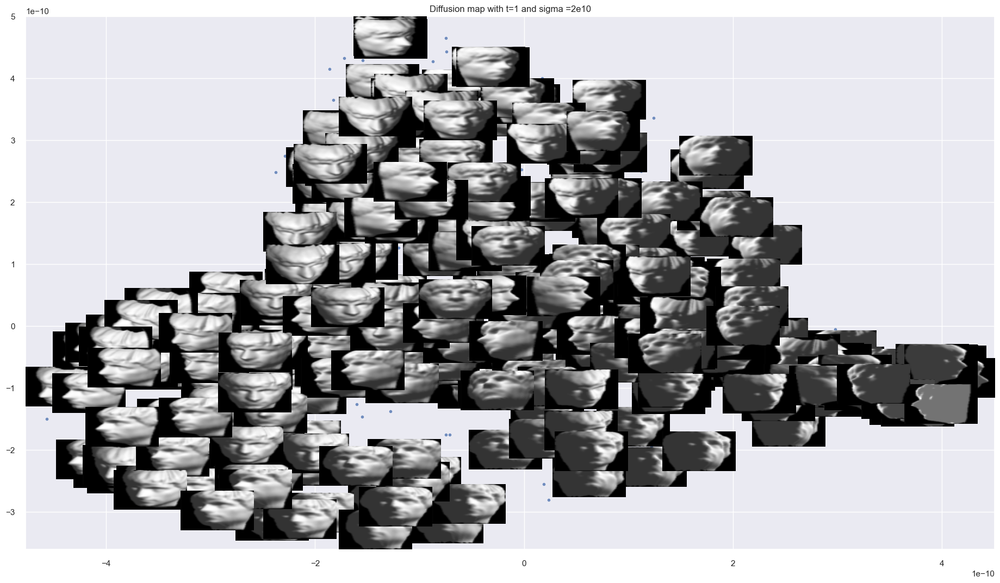

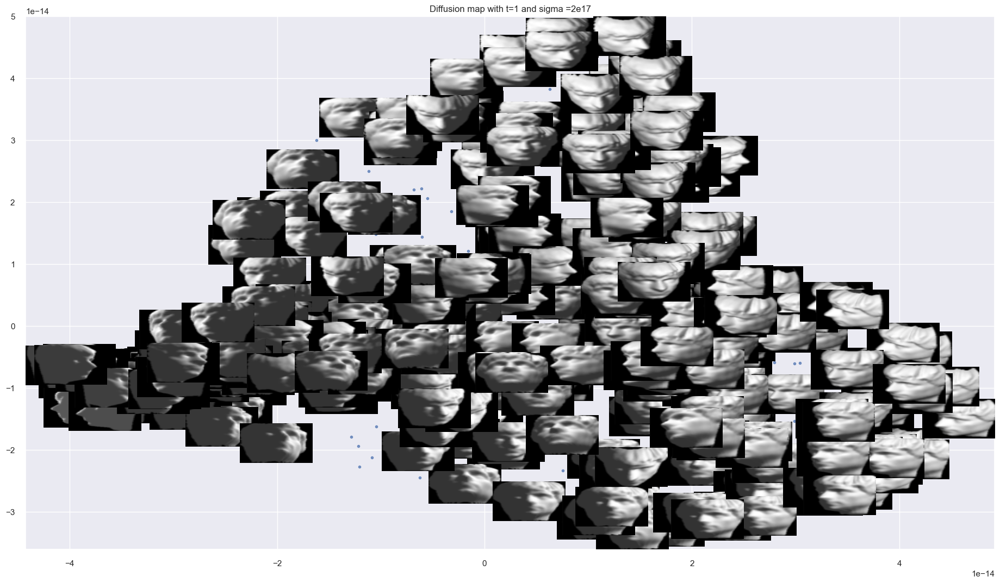

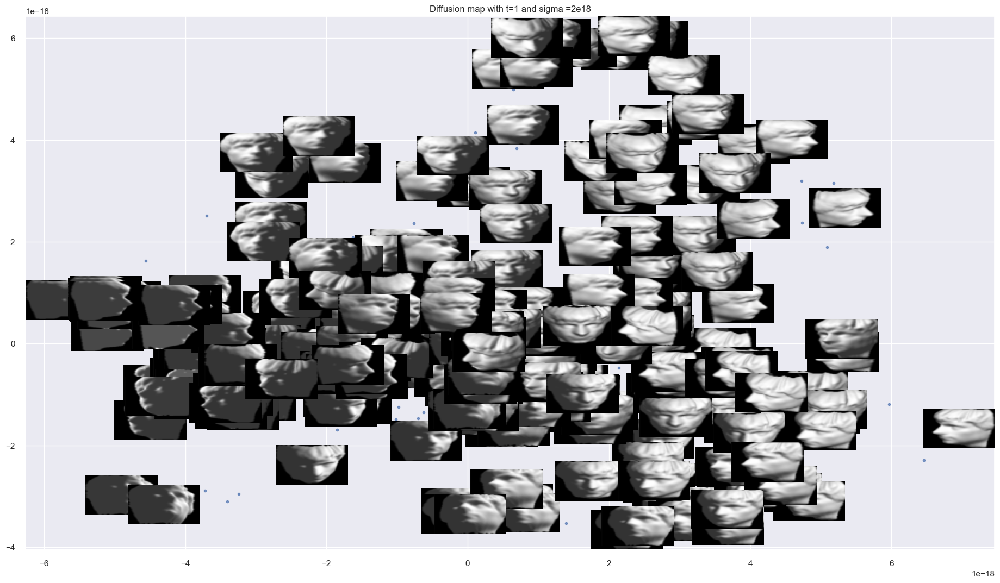

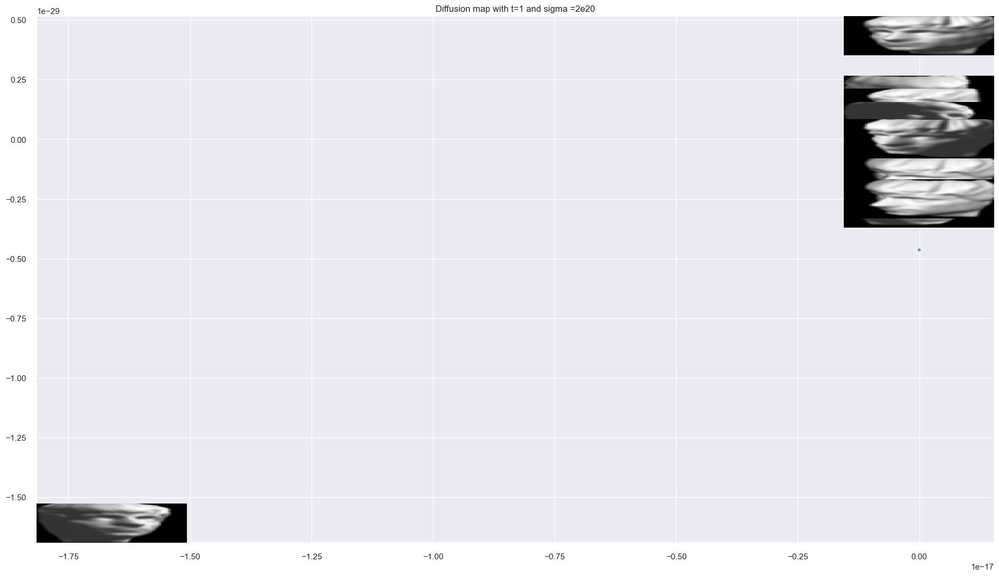

In [36]:

X_transformed=DiffusionMap(X,2,2e10,1)
c1,ax1=plot_with_images(X_transformed[0],X,"Diffusion map with t=1 and sigma =2e10",image_num=400)
plt.show()


X_transformed=DiffusionMap(X,2,2e14,1)
c3,ax3=plot_with_images(X_transformed[0],X,"Diffusion map with t=1 and sigma =2e17",image_num=400)
plt.show()


X_transformed=DiffusionMap(X,2,2e18,1)
c5,ax5=plot_with_images(X_transformed[0],X,"Diffusion map with t=1 and sigma =2e18",image_num=400)
plt.show()

X_transformed=DiffusionMap(X,2,2e20,1)
c6,ax6=plot_with_images(X_transformed[0],X,"Diffusion map with t=1 and sigma =2e20",image_num=400)
plt.show()

#### Conclusion :
The plots for 2e10 , 2e14 , 2e18 Represent a slow attemp to separate the entanglement of the low intensity cluster and we can see that more diversity
in the low intenisty grpah. Trying out 2e20 results in a collapse (I assume they converged to almost uniform distribution over the transition matrix.)
therefore we stay  with 2e18 which seems to be optimal.
### Finding t :
Now we need to find strucutre scope which provide the most cohesive graph. It is done by gradully accetping t
until we reach a graph that's acceptalbe to us and both axis represents what we desire.

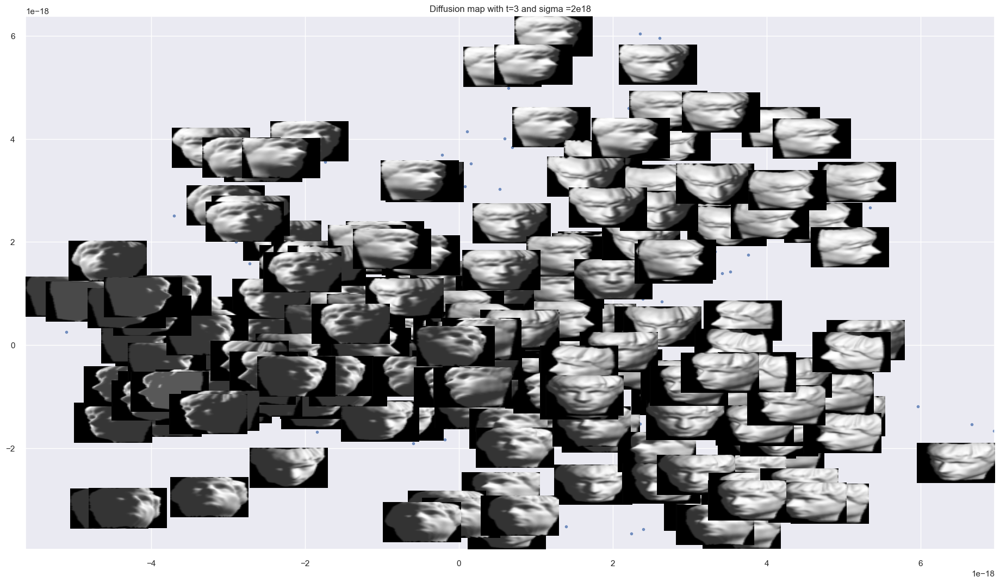

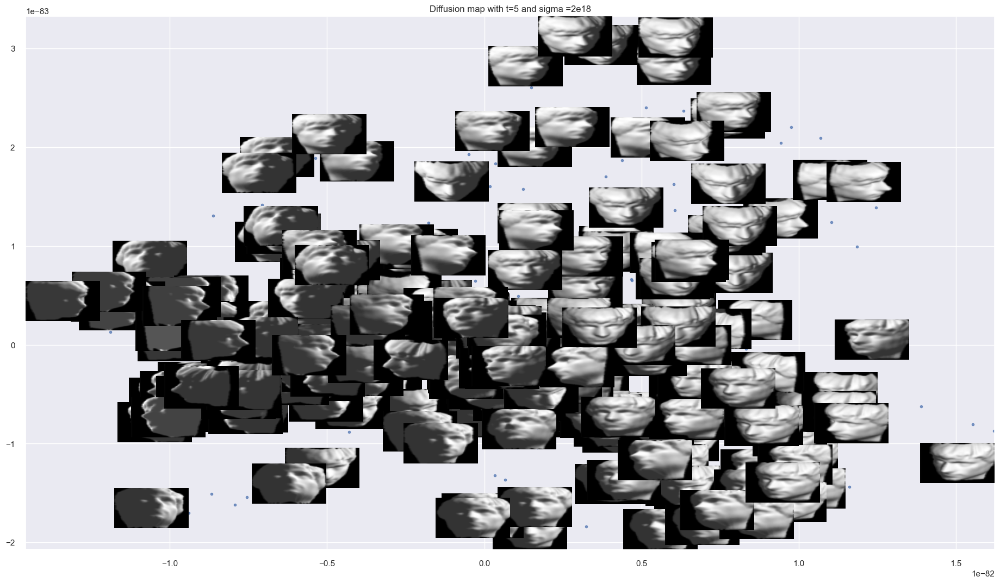

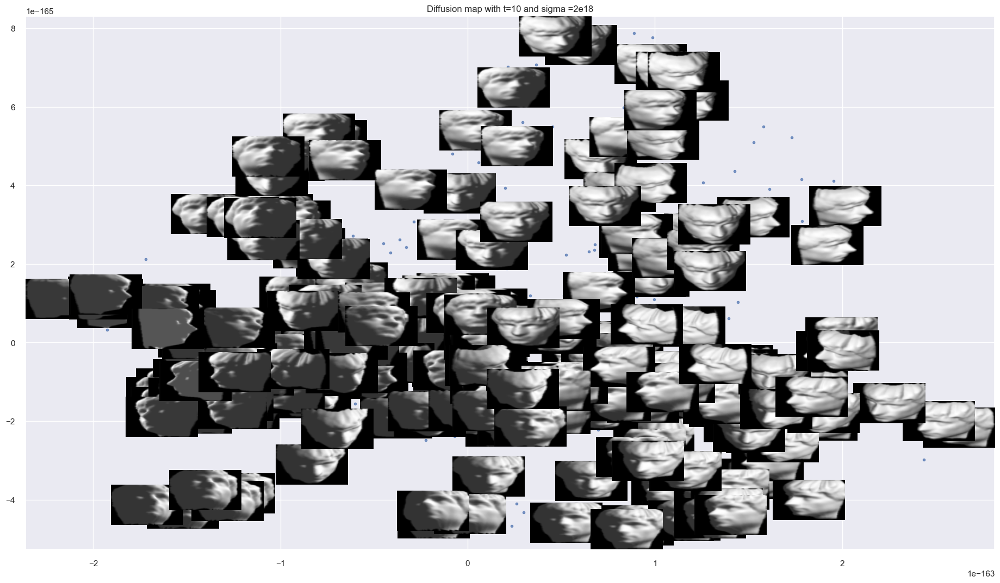

In [37]:

X_transformed=DiffusionMap(X,2,2e18,1)
c7,ax7=plot_with_images(X_transformed[0],X,"Diffusion map with t=3 and sigma =2e18",image_num=400)
plt.show()


X_transformed=DiffusionMap(X,2,2e18,5)
c8,ax8=plot_with_images(X_transformed[0],X,"Diffusion map with t=5 and sigma =2e18",image_num=400)
plt.show()


X_transformed=DiffusionMap(X,2,2e18,10)
c9,ax9=plot_with_images(X_transformed[0],X,"Diffusion map with t=10 and sigma =2e18",image_num=400)
plt.show()




#### Conclusion :
t=10 make the graph too dense since he's too focused  on global structure. t=5 and sigma= 2e18 seems to a good point in
the trade off which seperate the x axis into a wide intensity level axis and y-axis is a d.o.f :
#### Y axis :
- Top : Right direction
- Botoom : Left direction
- Middle : Forward

#### X axis :
- Left : Low average intensity.
- Right : High average intensity.

Remark :  While the intensity is the x-axis here and y-axis  is an attempt to approximate the D.O.F there still is a  lack of accuracy
of the D.O.F which is noticable.



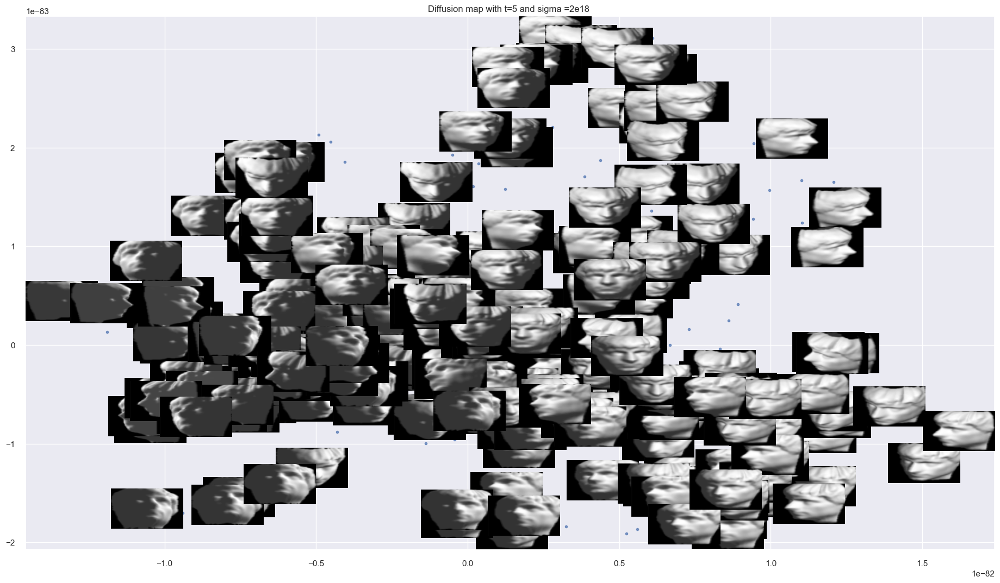

In [38]:
X_transformed=DiffusionMap(X,2,2e18,5)
c,ax=plot_with_images(X_transformed[0],X,"Diffusion map with t=5 and sigma =2e18 ",image_num=400)


# Comparing the algorithems :
______

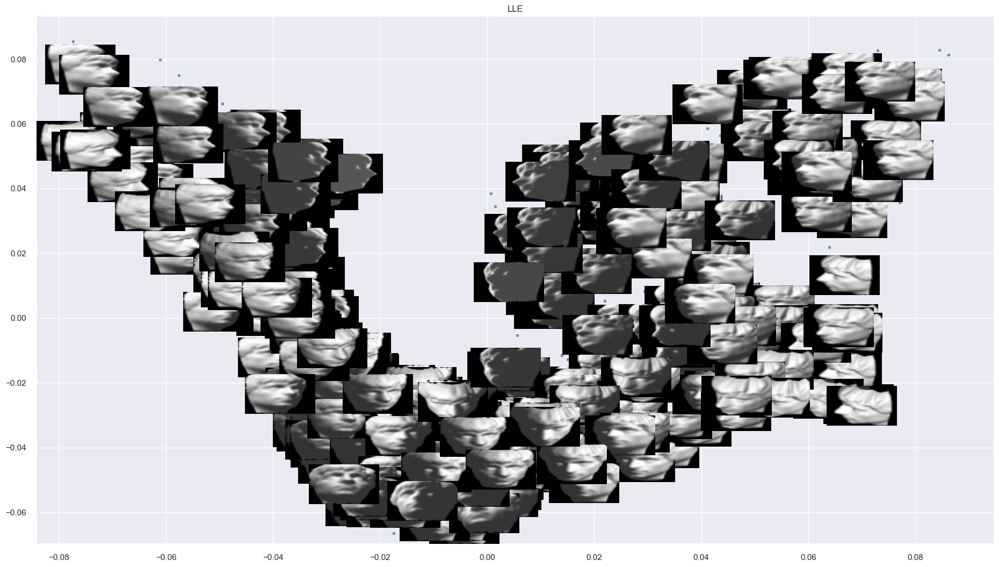

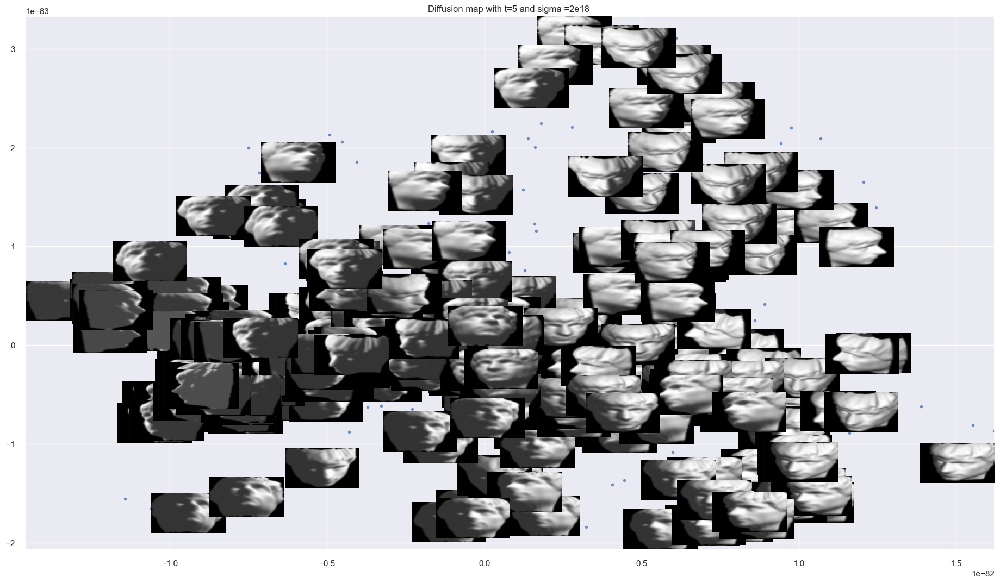

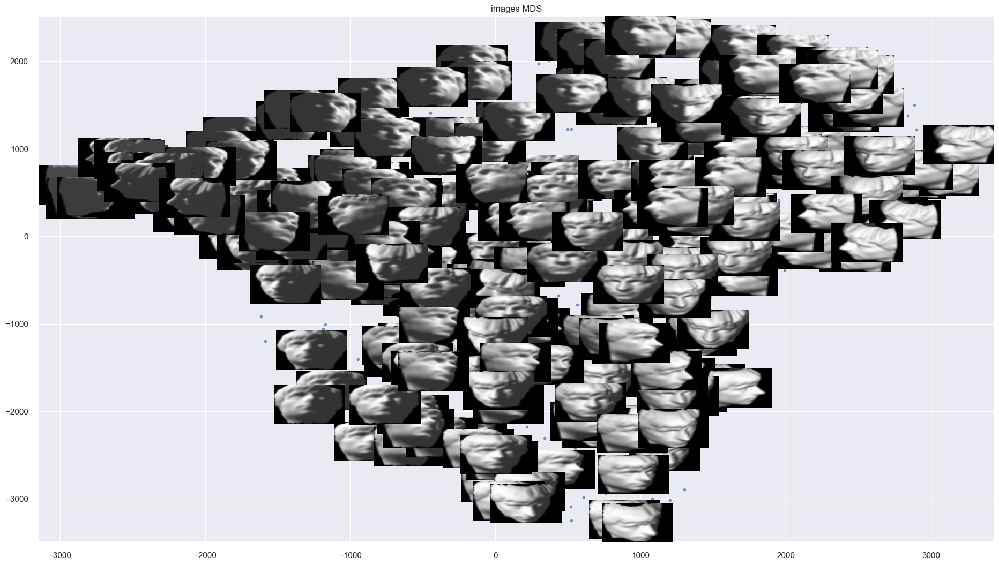

In [39]:
embedding = LocallyLinearEmbedding(n_components=2,n_neighbors=15)
X_transformed = embedding.fit_transform(X)
a=plot_with_images(X_transformed,X,"LLE",image_num=400)
plt.show()
X_transformed=DiffusionMap(X,2,2e18,5)
c,ax=plot_with_images(X_transformed[0],X,"Diffusion map with t=5 and sigma =2e18 ",image_num=400)
plt.show()
X_fit=MDS(X,2)

b,ax=plot_with_images(X_fit,X,"images MDS",image_num=400)

plt.show()

## LLE vs DFM vs MDS:
 - **Intensity entalgment** :LLE and  managed to break the entaglment of the low intensity average better
 - **D.O.F Accuracy** : MDS and DFM got around the same accuracy regarding D.O.F , and both get vastly outperformed by the LLE.
 - **Seperate axis for both aspects** :Both MDS and DFM managed to produce the intensity levels on an axis while LLE did it as a cluster , which is worse
 for ineteprbability of the graph ,
 
# Conclusion :
_____
LLE  vastly better accuracy regarding D.O.F and intensity levels  at the cost of cluster based reduction instead of axis
would be the best choice IMO.


